# YOLO v8 for Detection
- **Author:** BrenoAV
- **Date:** 09-12-2023

# Libraries

In [1]:
from glob import glob
import os
from pathlib import Path
from ultralytics import YOLO
import yaml
import matplotlib.pyplot as plt
from PIL import Image

In [14]:
%matplotlib inline

# Constants

In [2]:
TRAIN_IMAGES_DATASET_PATH = Path("/home/brenoav/Datasets/road signs.v2-release.yolov8/train/images")
VAL_IMAGES_DATASET_PATH = Path("/home/brenoav/Datasets/road signs.v2-release.yolov8/valid/images")
TEST_IMAGES_DATASET_PATH = Path("/home/brenoav/Datasets/road signs.v2-release.yolov8/valid/images")
CLASSES_NAMES = ['bus_stop', 'do_not_enter', 'do_not_stop', 
                 'do_not_turn_l', 'do_not_turn_r', 'do_not_u_turn', 
                 'enter_left_lane', 'green_light', 'left_right_lane', 
                 'no_parking', 'parking', 'ped_crossing', 'ped_zebra_cross', 
                 'railway_crossing', 'red_light', 'stop', 't_intersection_l', 
                 'traffic_light', 'u_turn', 'warning', 'yellow_light']
NUM_CLASSES = len(CLASSES_NAMES)

In [3]:
# Checking if the path exists
if not TRAIN_IMAGES_DATASET_PATH.exists():
    print(f"The {TRAIN_IMAGES_DATASET_PATH} doesn't exist!")
if not VAL_IMAGES_DATASET_PATH.exists():
    print(f"The {VAL_IMAGES_DATASET_PATH} doesn't exist!")
if not TEST_IMAGES_DATASET_PATH.exists():
    print(f"The {TEST_IMAGES_DATASET_PATH} doesn't exist!")
if TRAIN_IMAGES_DATASET_PATH.exists() and VAL_IMAGES_DATASET_PATH.exists()\
        and TEST_IMAGES_DATASET_PATH.exists():
    print(f"Everything is fine!")

Everything is fine!


# Creating config yaml file

In [4]:
dict_to_yaml = {
    "train": str(TRAIN_IMAGES_DATASET_PATH),
    "val": str(VAL_IMAGES_DATASET_PATH),
    "test": str(TEST_IMAGES_DATASET_PATH),
    "nc": NUM_CLASSES,
    "names": CLASSES_NAMES
}

In [5]:
with open("data.yaml", "w", encoding="utf-8") as yaml_file:
    yaml.dump(dict_to_yaml, yaml_file, sort_keys=False)

# Load Pre-Trained Model

In [6]:
model = YOLO("yolov8n.pt")  # Loading the pre trained model

# Training & Evaluation

In [7]:
results = model.train(data="data.yaml", 
                      project=os.path.join(os.getcwd(), "run"), 
                      epochs=30, 
                      imgsz=640, 
                      device=0)

Ultralytics YOLOv8.0.176 🚀 Python-3.10.13 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=30, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=/home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=Fals

In [8]:
model.val()

Ultralytics YOLOv8.0.176 🚀 Python-3.10.13 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
Model summary (fused): 168 layers, 3009743 parameters, 0 gradients
val: Scanning /home/brenoav/Datasets/road signs.v2-release.yolov8/valid/labels.cache... 48
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 
                   all        488        529      0.931       0.91      0.953      0.806
          do_not_enter        488         30      0.935      0.965      0.989       0.93
           do_not_stop        488         30      0.923      0.933      0.962        0.9
         do_not_turn_l        488         34       0.91      0.971      0.988      0.889
         do_not_turn_r        488         31      0.973      0.935      0.968      0.907
         do_not_u_turn        488         30      0.904      0.947      0.956      0.834
       enter_left_lane        488         30      0.951          1       0.97      0.856
           green_light   

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 12, 13, 14, 15, 16, 17, 19, 20])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f600441bd30>
fitness: 0.8208847593265362
keys: ['metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)']
maps: array([     0.8062,     0.93012,     0.90046,       0.889,     0.90702,     0.83417,     0.85599,     0.75929,     0.91021,     0.82646,      0.8062,      0.8062,     0.81723,     0.73312,     0.56978,     0.75913,     0.77224,     0.84157,      0.8062,      0.8532,     0.54643])
names: {0: 'bus_stop', 1: 'do_not_enter', 2: 'do_not_stop', 3: 'do_not_turn_l', 4: 'do_not_turn_r', 5: 'do_not_u_turn', 6: 'enter_left_lane', 7: 'green_light', 8: 'left_right_lane', 9: 'no_parking', 10: 'parking', 11: 'ped_crossing', 12: 'ped_zebra_cross', 13: 'railway_crossing', 14: 'red_light', 15: 's

In [9]:
# Saving the model
success = model.export(format='onnx')

Ultralytics YOLOv8.0.176 🚀 Python-3.10.13 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)

PyTorch: starting from '/home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 25, 8400) (6.0 MB)

ONNX: starting export with onnx 1.14.1 opset 17...
ONNX: export success ✅ 0.5s, saved as '/home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/train/weights/best.onnx' (11.7 MB)

Export complete (0.5s)
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/train/weights
Predict:         yolo predict task=detect model=/home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/train/weights/best.onnx imgsz=640 data=data.yaml  
Visualize:       https://netron.app


============= Diagnostic Run torch.onnx.export version 2.0.1+cu117 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



# Prediction

## Load best model

In [11]:
model = YOLO("run/train/weights/best.pt")

## Predicting

Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict2
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict3
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict4
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict5
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict6
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict7
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict8
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict9
Results saved to /home/brenoav/GitHub/ComputerVision/ObjectDetection/YOLOv8/run/predict/predict10
Results saved to /home/brenoav

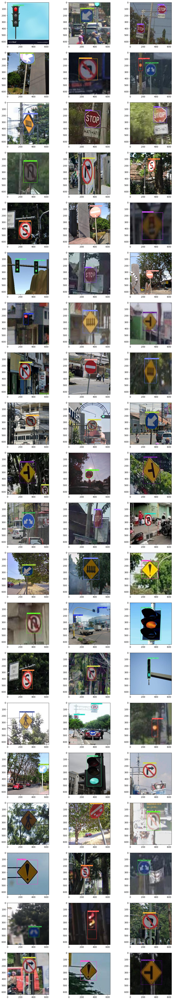

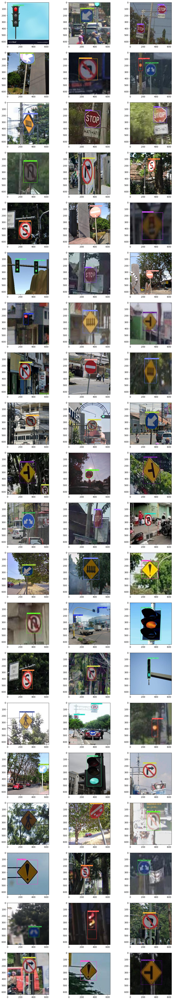

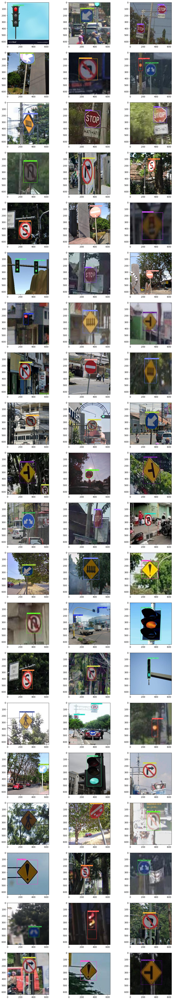

In [15]:
plt.figure(figsize=(14, 80))
for i, img_file in enumerate(glob(os.path.join(TEST_IMAGES_DATASET_PATH, "*.jpg"))[:60], start=1):
    plt.subplot(20, 3, i)
    results = model.predict(source=img_file, 
                            save=True, 
                            project=os.path.join(os.getcwd(), "run", "predict"), 
                            verbose=False)

    # Obtain the path of the file saved
    filepath = os.path.join(results[0].save_dir, os.path.basename(results[0].path))
    im_res = Image.open(filepath)
    plt.imshow(im_res)